# Week 5: Midterm - Max Garcia
## Description: Exploring race data in LA County's supervisorial districts 2 & 5 to understand park equity.
## Author: Max Garcia
## In a group with: Annie Chan, Miles Kim Parr, Aydin Pasebani, and Rodrigo Gutierrez

## Description: This week I will continue my exploration of race data by expanding it to the 2nd and 5th Supervisorial Districts of LA County. I will look at this data in conjunction with parks data to see if there are any trends I can easily spot through mapping. The goal will be to produce this into an interactive folium map so that I can begin to find an answer to our research question: what is the correlation between access to parks and green space in unincorporated LA County?


### First, I'm going to import the pandas and geopandas libraries.

In [63]:
import pandas as pd 
import geopandas as gpd

### Next, I'm going to load in the dataset I downloaded from the US Census website. I originally downloaded 2022 racial identity data by census tracts in LA County (from the ACS 5-year estimates) as a .zip file. Then I used Chris' instructions to split the GEO_ID column to get FIPS codes in Microsoft Excel. I also renamed columns in Microsoft Excel before I realized it could be done in python. This worked, but I found that the numbers were not aligning in calculations due to each column's margin of error, so I have to use 2020 data.

In [64]:
race = pd.read_csv(
    'data/Race_Data.csv',
    dtype=
    {
        'GEO_ID':str,
    }
)

### Following the lecture, I'm imported the data with GEO_ID as a string to ensure that the leading zeros are included.
### From here, I'm going to take a look at the data and see exactly what I have to work with. 

# Preliminary Inspection

In [65]:
race.shape

(2498, 9)

In [66]:
race.head()

,GEO_ID,Total,White,Black,NativeAmerican,Asian,HawaiianAPI,Other,Twoplus
0,6037101110,4926,3065,74,53,440,10,743,541
1,6037101122,3728,2723,31,28,404,0,211,331
2,6037101220,3344,1901,42,40,358,1,625,377
3,6037101221,3444,2009,87,20,248,3,734,343
4,6037101222,2808,1551,94,62,148,0,650,303


### Hmmmm... there is still a leading zero error. Let me try to fix that.

In [67]:
race['GEO_ID'] = race['GEO_ID'].str.zfill(11)
race.head()

,GEO_ID,Total,White,Black,NativeAmerican,Asian,HawaiianAPI,Other,Twoplus
0,06037101110,4926,3065,74,53,440,10,743,541
1,06037101122,3728,2723,31,28,404,0,211,331
2,06037101220,3344,1901,42,40,358,1,625,377
3,06037101221,3444,2009,87,20,248,3,734,343
4,06037101222,2808,1551,94,62,148,0,650,303


### Great! Now I want to confirm what columns of data I am working with. I forgot we can do this in python, but I think it was helpful to do it there since I had be receiving Dtype errors before. 

In [68]:
race.info(verbose=True, show_counts=True)

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2498 entries, 0 to 2497
Data columns (total 9 columns):
 #   Column          Non-Null Count  Dtype 
---  ------          --------------  ----- 
 0   GEO_ID          2498 non-null   object
 1   Total           2498 non-null   int64 
 2   White           2498 non-null   int64 
 3   Black           2498 non-null   int64 
 4   NativeAmerican  2498 non-null   int64 
 5   Asian           2498 non-null   int64 
 6   HawaiianAPI     2498 non-null   int64 
 7   Other           2498 non-null   int64 
 8   Twoplus         2498 non-null   int64 
dtypes: int64(8), object(1)
memory usage: 175.8+ KB


### Lastly, I'll confirm that there are no columns that are entirely empty.

In [69]:
race.columns[race.isna().all()].tolist()

[]

### In conclusion, using the shape, head, and info to look at the data, there are 2498 rows and 22 columns in the dataset. These represent the census tracts in LA County and the racial indicators I will be inspecting.  

### However, I noticed that the data gives me counts of each racial group. This is nice and specific, but for this project, I want to look at race more broadly and how being non-white may affect your access to parks. Let me make a new column for this that gives me a percentage.

In [70]:
race['nonwhite'] = race['Black'] + race['NativeAmerican'] + race['Asian'] + race['HawaiianAPI'] + race['Other'] + race['Twoplus']
race['tracts_nonwhite'] = race['nonwhite'] / race['Total']
race.head()

,GEO_ID,Total,White,Black,NativeAmerican,Asian,HawaiianAPI,Other,Twoplus,nonwhite,tracts_nonwhite
0,06037101110,4926,3065,74,53,440,10,743,541,1861,0.377791
1,06037101122,3728,2723,31,28,404,0,211,331,1005,0.269582
2,06037101220,3344,1901,42,40,358,1,625,377,1443,0.431519
3,06037101221,3444,2009,87,20,248,3,734,343,1435,0.416667
4,06037101222,2808,1551,94,62,148,0,650,303,1257,0.447650


### I will now make this column's decimal values into percentages. 

In [71]:
race['tracts_nonwhite'] = race['tracts_nonwhite'] * 100

In [72]:
race.head()

,GEO_ID,Total,White,Black,NativeAmerican,Asian,HawaiianAPI,Other,Twoplus,nonwhite,tracts_nonwhite
0,06037101110,4926,3065,74,53,440,10,743,541,1861,37.779131
1,06037101122,3728,2723,31,28,404,0,211,331,1005,26.958155
2,06037101220,3344,1901,42,40,358,1,625,377,1443,43.151914
3,06037101221,3444,2009,87,20,248,3,734,343,1435,41.666667
4,06037101222,2808,1551,94,62,148,0,650,303,1257,44.764957


### While I'm at it, I'm going to get the percent of white people in each census tract by using the numbers I just calculated

In [73]:
race['percent_white'] = 100 - race['tracts_nonwhite']
race.head()

,GEO_ID,Total,White,Black,NativeAmerican,Asian,HawaiianAPI,Other,Twoplus,nonwhite,tracts_nonwhite,percent_white
0,06037101110,4926,3065,74,53,440,10,743,541,1861,37.779131,62.220869
1,06037101122,3728,2723,31,28,404,0,211,331,1005,26.958155,73.041845
2,06037101220,3344,1901,42,40,358,1,625,377,1443,43.151914,56.848086
3,06037101221,3444,2009,87,20,248,3,734,343,1435,41.666667,58.333333
4,06037101222,2808,1551,94,62,148,0,650,303,1257,44.764957,55.235043


### Nice. This will be useful for making my maps legible later.

# Charts
### I will start by creating a histogram that plots totals of people in the census tracts. 

<Axes: ylabel='Frequency'>

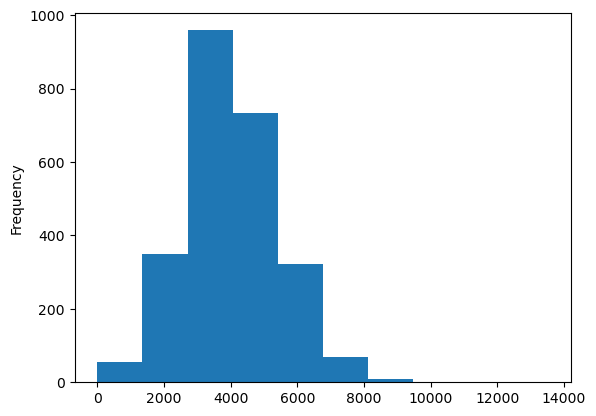

In [74]:
race['Total'].plot.hist()

### Most census tracts seem to have between 2,000 and 6,000 people.

<Axes: >

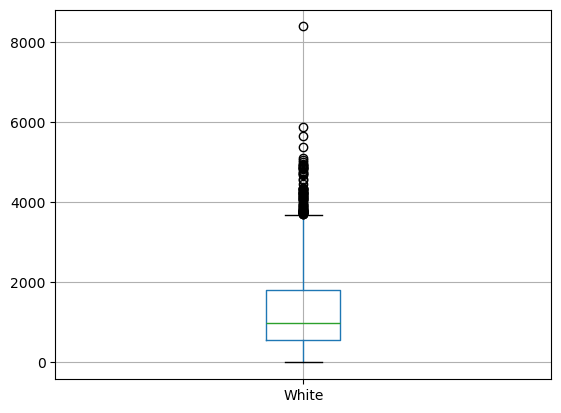

In [75]:
race.boxplot(column=['White'])

<Axes: xlabel='White', ylabel='tracts_nonwhite'>

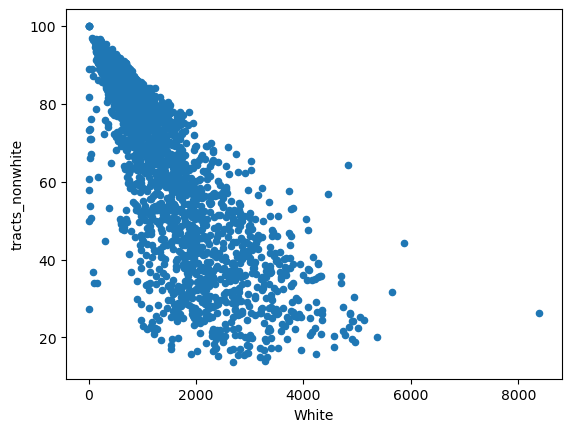

In [76]:
race.plot.scatter(x='White', y='tracts_nonwhite')

### This scatter plot is really interesting. The positive skew demonstrates a divide between White people and People of Color in the county, showing that where the total number of Black people is high, the number of white people is low and vice versa.

# Sorting and Filtering Data
### Given that LA County is clearly still very segregated, I want to look at which census tracts are home to the most of each racial group in my list (for clarification, this will not include two or more races). Determining where people identifying with each category may be useful for our research question which looks at disparities in access to parks and other public space.

In [77]:
race.sort_values(by='White', ascending = False)[['GEO_ID', 'White']].head(10)

,GEO_ID,White
2278,06037702900,8393
1028,06037275604,5872
2176,06037621201,5654
1123,06037301502,5373
2175,06037621104,5119
2290,06037800324,5048
2254,06037701304,5010
923,06037262604,4959
1111,06037300800,4941
2255,06037701402,4922


In [78]:
race.sort_values(by='Black', ascending = False)[['GEO_ID', 'Black']].head(10)

,GEO_ID,Black
1814,06037543304,4979
1818,06037543322,4796
2279,06037703002,4462
2282,06037703200,4267
861,06037238000,4026
2281,06037703100,3924
863,06037238200,3666
2086,06037601302,3492
1817,06037543321,3339
1783,06037541200,3256


In [79]:
race.sort_values(by='NativeAmerican', ascending = False)[['GEO_ID', 'NativeAmerican']].head(10)

,GEO_ID,NativeAmerican
1763,06037536104,462
622,06037208903,393
623,06037208904,341
1762,06037536103,312
632,06037209402,311
1766,06037540000,283
2399,06037911100,283
1176,06037320300,267
1274,06037404301,265
2149,06037604200,262


In [80]:
race.sort_values(by='Asian', ascending = False)[['GEO_ID', 'Asian']].head(10)

,GEO_ID,Asian
938,06037265301,5921
1411,06037431701,5153
1370,06037408703,4967
1372,06037408707,4837
1567,06037482600,4790
1248,06037403324,4656
1396,06037430801,4629
1912,06037554512,4515
1536,06037481401,4487
1552,06037482002,4375


In [81]:
race.sort_values(by='HawaiianAPI', ascending = False)[['GEO_ID', 'HawaiianAPI']].head(10)

,GEO_ID,HawaiianAPI
1816,06037543306,234
1820,06037543501,176
1981,06037572500,159
1833,06037543803,152
1972,06037571701,133
1982,06037572600,129
1950,06037570502,124
1942,06037570204,124
1980,06037572301,123
1947,06037570402,117


In [82]:
race.sort_values(by='Other', ascending = False)[['GEO_ID', 'Other']].head(10)

,GEO_ID,Other
1740,06037535101,4418
1665,06037531302,4285
1691,06037532900,4159
1679,06037532101,3996
1743,06037535300,3972
1176,06037320300,3960
1766,06037540000,3955
1768,06037540102,3900
1737,06037534900,3894
1604,06037502303,3808


In [83]:
race.sort_values(by='Twoplus', ascending = False)[['GEO_ID', 'Twoplus']].head(10)

,GEO_ID,Twoplus
1604,06037502303,2139
1611,06037502700,2009
1847,06037550700,1951
1309,06037406103,1877
1612,06037502801,1869
1623,06037503401,1851
1593,06037501600,1806
1643,06037530007,1771
1581,06037500700,1749
1625,06037503501,1683


### While I can't group these into smaller ranges because they are qualitative identifiers, it is interesting to note that, based on the FIPS codes, people seem to be clustered by race. In the next step I am going to see if this is true. 

# Merging the Race Dataset with Census Tract Data

In [84]:
tracts = gpd.read_file('data/2020_Census_Tracts.geojson')

In [85]:
tracts.columns[tracts.isna().all()].tolist()

[]

In [86]:
tracts.head()

,OBJECTID,CT20,LABEL,ShapeSTArea,ShapeSTLength,geometry
0,4992,101110,1011.10,1.229562e+07,15083.854287,"POLYGON ((-118.29793 34.26323, -118.30082 34.2..."
1,4993,101122,1011.22,2.845774e+07,31671.455844,"POLYGON ((-118.27743 34.25991, -118.27743 34.2..."
2,4994,101220,1012.20,7.522093e+06,12698.783810,"POLYGON ((-118.27818 34.25577, -118.27887 34.2..."
3,4995,101221,1012.21,3.812000e+06,9161.710543,"POLYGON ((-118.28735 34.25591, -118.28863 34.2..."
4,4996,101222,1012.22,3.191371e+06,9980.600461,"POLYGON ((-118.28594 34.25590, -118.28697 34.2..."


### Now I'm going to plot all of the data to see what it looks like from the file.

<Axes: >

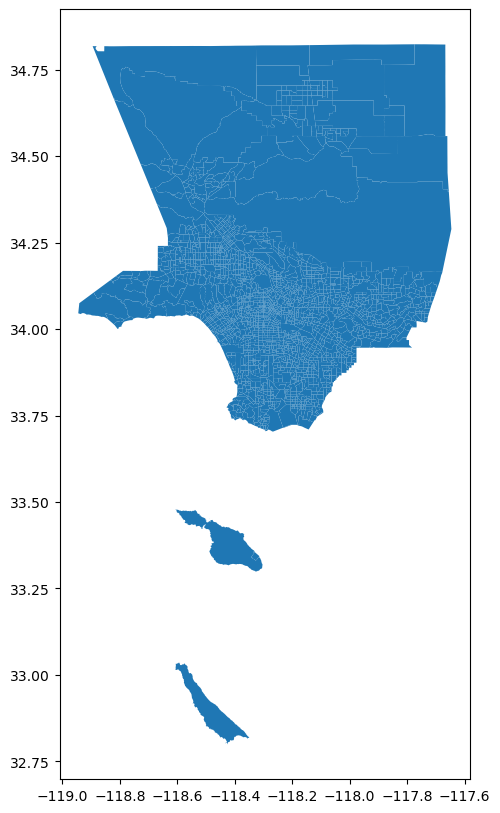

In [87]:
tracts.plot(figsize=(12,10))

### Let's see what the categories are.

In [88]:
tracts.info(verbose=True, show_counts=True)

<class 'geopandas.geodataframe.GeoDataFrame'>
RangeIndex: 2496 entries, 0 to 2495
Data columns (total 6 columns):
 #   Column         Non-Null Count  Dtype   
---  ------         --------------  -----   
 0   OBJECTID       2496 non-null   int64   
 1   CT20           2496 non-null   object  
 2   LABEL          2496 non-null   object  
 3   ShapeSTArea    2496 non-null   float64 
 4   ShapeSTLength  2496 non-null   float64 
 5   geometry       2496 non-null   geometry
dtypes: float64(2), geometry(1), int64(1), object(2)
memory usage: 117.1+ KB


### There isn't a FIPS column, which will be necessary for my merge. I'm going to make one using the GEOID variable which corresponds to census tracts.

In [89]:
tracts['GEO_ID'] ='06' + '037' + tracts['CT20']
tracts.head()

,OBJECTID,CT20,LABEL,ShapeSTArea,ShapeSTLength,geometry,GEO_ID
0,4992,101110,1011.10,1.229562e+07,15083.854287,"POLYGON ((-118.29793 34.26323, -118.30082 34.2...",06037101110
1,4993,101122,1011.22,2.845774e+07,31671.455844,"POLYGON ((-118.27743 34.25991, -118.27743 34.2...",06037101122
2,4994,101220,1012.20,7.522093e+06,12698.783810,"POLYGON ((-118.27818 34.25577, -118.27887 34.2...",06037101220
3,4995,101221,1012.21,3.812000e+06,9161.710543,"POLYGON ((-118.28735 34.25591, -118.28863 34.2...",06037101221
4,4996,101222,1012.22,3.191371e+06,9980.600461,"POLYGON ((-118.28594 34.25590, -118.28697 34.2...",06037101222


In [90]:
tracts.info(verbose=True, show_counts=True)

<class 'geopandas.geodataframe.GeoDataFrame'>
RangeIndex: 2496 entries, 0 to 2495
Data columns (total 7 columns):
 #   Column         Non-Null Count  Dtype   
---  ------         --------------  -----   
 0   OBJECTID       2496 non-null   int64   
 1   CT20           2496 non-null   object  
 2   LABEL          2496 non-null   object  
 3   ShapeSTArea    2496 non-null   float64 
 4   ShapeSTLength  2496 non-null   float64 
 5   geometry       2496 non-null   geometry
 6   GEO_ID         2496 non-null   object  
dtypes: float64(2), geometry(1), int64(1), object(3)
memory usage: 136.6+ KB


### This tells me that I've got good spatial data to work with. I'm ready to merge the datasets.

### I'll start by renaming the GEO_ID column in the race dataset to FIPS so I can make the 1:1 join.

In [91]:
race.info(verbose=True, show_counts=True)

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2498 entries, 0 to 2497
Data columns (total 12 columns):
 #   Column           Non-Null Count  Dtype  
---  ------           --------------  -----  
 0   GEO_ID           2498 non-null   object 
 1   Total            2498 non-null   int64  
 2   White            2498 non-null   int64  
 3   Black            2498 non-null   int64  
 4   NativeAmerican   2498 non-null   int64  
 5   Asian            2498 non-null   int64  
 6   HawaiianAPI      2498 non-null   int64  
 7   Other            2498 non-null   int64  
 8   Twoplus          2498 non-null   int64  
 9   nonwhite         2498 non-null   int64  
 10  tracts_nonwhite  2488 non-null   float64
 11  percent_white    2488 non-null   float64
dtypes: float64(2), int64(9), object(1)
memory usage: 234.3+ KB


### Time to make the merge using FIPS. This will allow me to overlay the racial data on their corresponding census tract.

In [92]:
tracts_race = tracts.merge(race,on ="GEO_ID")

In [93]:
tracts_race.columns[tracts_race.isna().all()].tolist()

[]

In [94]:
tracts_race.head(10)

,OBJECTID,CT20,LABEL,ShapeSTArea,ShapeSTLength,geometry,GEO_ID,Total,White,Black,NativeAmerican,Asian,HawaiianAPI,Other,Twoplus,nonwhite,tracts_nonwhite,percent_white
0,4992,101110,1011.10,1.229562e+07,15083.854287,"POLYGON ((-118.29793 34.26323, -118.30082 34.2...",06037101110,4926,3065,74,53,440,10,743,541,1861,37.779131,62.220869
1,4993,101122,1011.22,2.845774e+07,31671.455844,"POLYGON ((-118.27743 34.25991, -118.27743 34.2...",06037101122,3728,2723,31,28,404,0,211,331,1005,26.958155,73.041845
2,4994,101220,1012.20,7.522093e+06,12698.783810,"POLYGON ((-118.27818 34.25577, -118.27887 34.2...",06037101220,3344,1901,42,40,358,1,625,377,1443,43.151914,56.848086
3,4995,101221,1012.21,3.812000e+06,9161.710543,"POLYGON ((-118.28735 34.25591, -118.28863 34.2...",06037101221,3444,2009,87,20,248,3,734,343,1435,41.666667,58.333333
4,4996,101222,1012.22,3.191371e+06,9980.600461,"POLYGON ((-118.28594 34.25590, -118.28697 34.2...",06037101222,2808,1551,94,62,148,0,650,303,1257,44.764957,55.235043
5,4997,101300,1013.00,2.777377e+07,29384.860602,"POLYGON ((-118.26528 34.25238, -118.26539 34.2...",06037101300,4269,3347,28,9,353,2,155,375,922,21.597564,78.402436
6,4998,101400,1014.00,6.791532e+07,42668.928986,"POLYGON ((-118.29946 34.25598, -118.30027 34.2...",06037101400,3898,2712,44,32,324,3,334,449,1186,30.425859,69.574141
7,4999,102103,1021.03,1.277023e+07,16349.935002,"POLYGON ((-118.34336 34.22588, -118.34398 34.2...",06037102103,2107,1485,48,4,148,7,200,215,622,29.520645,70.479355
8,5000,102104,1021.04,1.785120e+07,27555.466359,"POLYGON ((-118.33807 34.22228, -118.33822 34.2...",06037102104,3906,2857,84,15,401,1,171,377,1049,26.856119,73.143881
9,5001,102105,1021.05,5.303654e+06,9962.251126,"POLYGON ((-118.34302 34.20656, -118.34374 34.2...",06037102105,1855,718,27,42,178,0,501,389,1137,61.293801,38.706199


# Maps

### Now I can see where white people are concentrated in LA County, for example.

<Axes: >

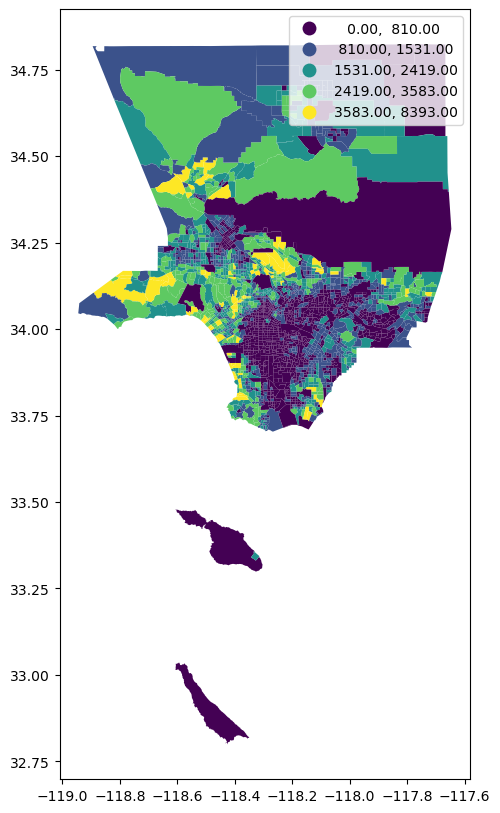

In [95]:
tracts_race.plot(figsize=(12,10),
                column='White',
                 legend=True, 
                 scheme='NaturalBreaks')

### And you can do the same thing with other races. For example, Black people are much less spread out in the county.

<Axes: >

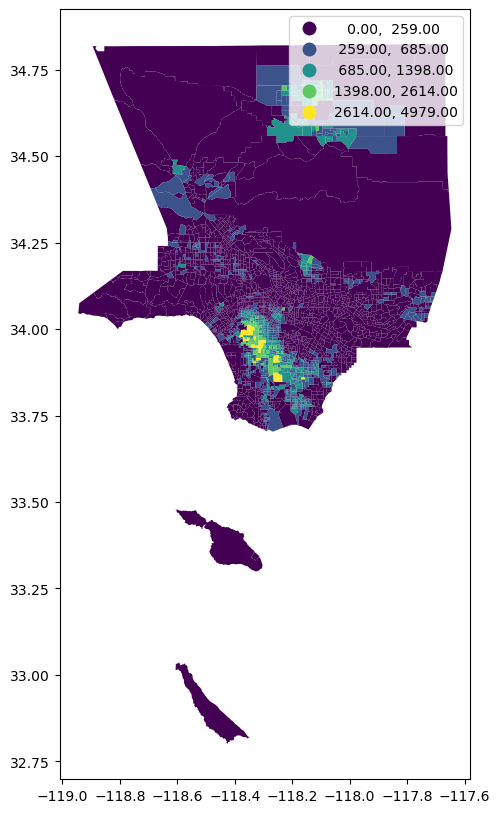

In [96]:
tracts_race.plot(figsize=(12,10),
                 column='Black',
                 legend=True, 
                 scheme='NaturalBreaks')

### Now I'll look at the new identifiers I've just created. 

### First, the percent of nonwhite people. 

<Axes: >

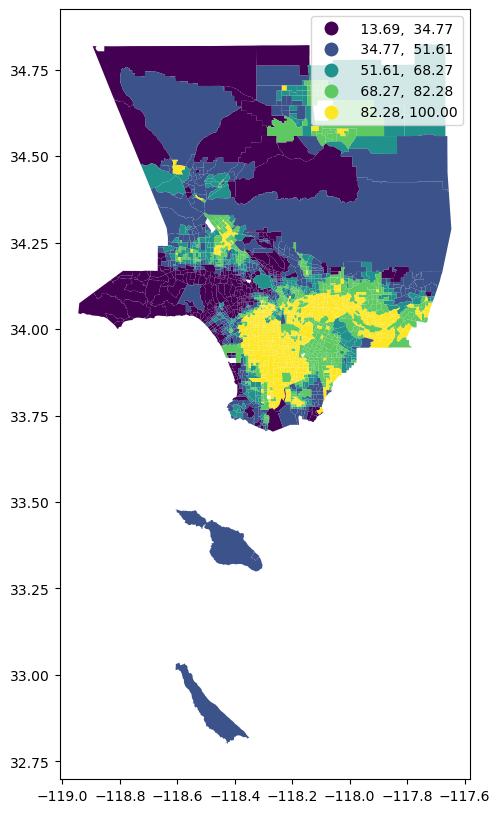

In [97]:
tracts_race.plot(figsize=(12,10),
                 column='tracts_nonwhite',
                 legend=True, 
                 scheme='NaturalBreaks')

### Second, the percent of white people. 

<Axes: >

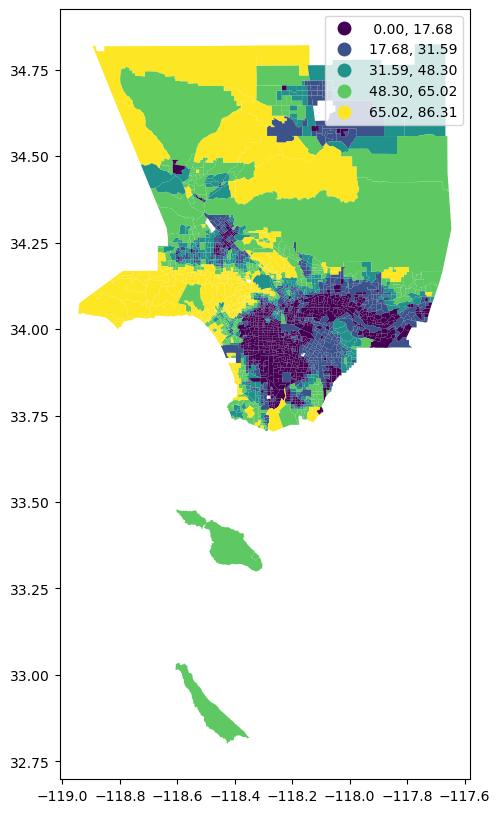

In [98]:
tracts_race.plot(figsize=(12,10),
                 column='percent_white',
                 legend=True, 
                 scheme='NaturalBreaks')

### Wow! These maps are almost inverted (sadly not surprising). However, looking at these maps, I realized that I don't know the Supervisorial Districts from this map. I downloaded a new CSV from LA County Census Tracts Viewer to try to look at just District 2. Once that works, I'll move on to District 5.

In [99]:
district2 = pd.read_csv(
    'data/District2.csv',
    dtype=
    {
        'CT20':str
    }
)
district2.info(verbose=True, show_counts=True)

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 506 entries, 0 to 505
Data columns (total 15 columns):
 #   Column         Non-Null Count  Dtype  
---  ------         --------------  -----  
 0   OBJECTID_12    506 non-null    int64  
 1   Join_Count     506 non-null    int64  
 2   TARGET_FID     506 non-null    int64  
 3   CT20           506 non-null    object 
 4   LABEL          506 non-null    float64
 5   NAME           506 non-null    object 
 6   SUP_NAME       506 non-null    object 
 7   DIST_SUP       506 non-null    int64  
 8   CITYNAME_ALF   451 non-null    object 
 9   NAME_1         66 non-null     object 
 10  JURISDICTION   506 non-null    object 
 11  AREA_NUM       506 non-null    int64  
 12  AREA_NAME      506 non-null    object 
 13  Shape__Area    506 non-null    float64
 14  Shape__Length  506 non-null    float64
dtypes: float64(3), int64(5), object(7)
memory usage: 59.4+ KB


In [100]:
district2.head(10)

,OBJECTID_12,Join_Count,TARGET_FID,CT20,LABEL,NAME,SUP_NAME,DIST_SUP,CITYNAME_ALF,NAME_1,JURISDICTION,AREA_NUM,AREA_NAME,Shape__Area,Shape__Length
0,640,2,640,211000,2110.00,2ND SUP. DISTRICT,2ND DISTRICT: HOLLY MITCHELL,2,LOS ANGELES,NaN,INCORPORATED CITY,5,Westside Planning Area,3.881413e+06,9270.888577
1,641,2,641,211121,2111.21,2ND SUP. DISTRICT,2ND DISTRICT: HOLLY MITCHELL,2,LOS ANGELES,NaN,INCORPORATED CITY,9,Metro Planning Area,3.125745e+05,2799.117227
2,642,3,642,211122,2111.22,2ND SUP. DISTRICT,2ND DISTRICT: HOLLY MITCHELL,2,LOS ANGELES,NaN,INCORPORATED CITY,9,Metro Planning Area,5.341218e+05,3050.487937
3,643,2,643,211123,2111.23,2ND SUP. DISTRICT,2ND DISTRICT: HOLLY MITCHELL,2,LOS ANGELES,NaN,INCORPORATED CITY,9,Metro Planning Area,2.513022e+05,2501.035059
4,644,2,644,211124,2111.24,2ND SUP. DISTRICT,2ND DISTRICT: HOLLY MITCHELL,2,LOS ANGELES,NaN,INCORPORATED CITY,9,Metro Planning Area,5.771177e+05,3012.923477
5,645,2,645,211201,2112.01,2ND SUP. DISTRICT,2ND DISTRICT: HOLLY MITCHELL,2,LOS ANGELES,NaN,INCORPORATED CITY,9,Metro Planning Area,2.036427e+05,1811.419313
6,646,3,646,211202,2112.02,2ND SUP. DISTRICT,2ND DISTRICT: HOLLY MITCHELL,2,LOS ANGELES,NaN,INCORPORATED CITY,9,Metro Planning Area,2.617965e+05,2048.091994
7,647,1,647,211310,2113.10,2ND SUP. DISTRICT,2ND DISTRICT: HOLLY MITCHELL,2,LOS ANGELES,NaN,INCORPORATED CITY,9,Metro Planning Area,2.103028e+05,1841.910789
8,648,1,648,211320,2113.20,2ND SUP. DISTRICT,2ND DISTRICT: HOLLY MITCHELL,2,LOS ANGELES,NaN,INCORPORATED CITY,9,Metro Planning Area,2.721546e+05,2090.392142
9,649,2,649,211410,2114.10,2ND SUP. DISTRICT,2ND DISTRICT: HOLLY MITCHELL,2,LOS ANGELES,NaN,INCORPORATED CITY,5,Metro Planning Area,3.956623e+05,2766.191348


### Like I did with the census tracts data, if I want to merge I have to give something for it to align to. Again, I will change the CT20 column to FIPS.

In [101]:
district2['GEO_ID'] ='06' + '037' + district2['CT20']
district2.info(verbose=True, show_counts=True)

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 506 entries, 0 to 505
Data columns (total 16 columns):
 #   Column         Non-Null Count  Dtype  
---  ------         --------------  -----  
 0   OBJECTID_12    506 non-null    int64  
 1   Join_Count     506 non-null    int64  
 2   TARGET_FID     506 non-null    int64  
 3   CT20           506 non-null    object 
 4   LABEL          506 non-null    float64
 5   NAME           506 non-null    object 
 6   SUP_NAME       506 non-null    object 
 7   DIST_SUP       506 non-null    int64  
 8   CITYNAME_ALF   451 non-null    object 
 9   NAME_1         66 non-null     object 
 10  JURISDICTION   506 non-null    object 
 11  AREA_NUM       506 non-null    int64  
 12  AREA_NAME      506 non-null    object 
 13  Shape__Area    506 non-null    float64
 14  Shape__Length  506 non-null    float64
 15  GEO_ID         506 non-null    object 
dtypes: float64(3), int64(5), object(8)
memory usage: 63.4+ KB


In [102]:
district2.head()

,OBJECTID_12,Join_Count,TARGET_FID,CT20,LABEL,NAME,SUP_NAME,DIST_SUP,CITYNAME_ALF,NAME_1,JURISDICTION,AREA_NUM,AREA_NAME,Shape__Area,Shape__Length,GEO_ID
0,640,2,640,211000,2110.00,2ND SUP. DISTRICT,2ND DISTRICT: HOLLY MITCHELL,2,LOS ANGELES,NaN,INCORPORATED CITY,5,Westside Planning Area,3.881413e+06,9270.888577,06037211000
1,641,2,641,211121,2111.21,2ND SUP. DISTRICT,2ND DISTRICT: HOLLY MITCHELL,2,LOS ANGELES,NaN,INCORPORATED CITY,9,Metro Planning Area,3.125745e+05,2799.117227,06037211121
2,642,3,642,211122,2111.22,2ND SUP. DISTRICT,2ND DISTRICT: HOLLY MITCHELL,2,LOS ANGELES,NaN,INCORPORATED CITY,9,Metro Planning Area,5.341218e+05,3050.487937,06037211122
3,643,2,643,211123,2111.23,2ND SUP. DISTRICT,2ND DISTRICT: HOLLY MITCHELL,2,LOS ANGELES,NaN,INCORPORATED CITY,9,Metro Planning Area,2.513022e+05,2501.035059,06037211123
4,644,2,644,211124,2111.24,2ND SUP. DISTRICT,2ND DISTRICT: HOLLY MITCHELL,2,LOS ANGELES,NaN,INCORPORATED CITY,9,Metro Planning Area,5.771177e+05,3012.923477,06037211124


### I can now merge the tracts_race dataset with district2. I'm doing this because the only way I can connect them is by their shape size. 

In [103]:
district2_tracts_race = tracts_race.merge(district2,on = "GEO_ID")
district2_tracts_race.head()

,OBJECTID,CT20_x,LABEL_x,ShapeSTArea,ShapeSTLength,geometry,GEO_ID,Total,White,Black,...,NAME,SUP_NAME,DIST_SUP,CITYNAME_ALF,NAME_1,JURISDICTION,AREA_NUM,AREA_NAME,Shape__Area,Shape__Length
0,5631,211000,2110.00,2.859668e+07,25170.331758,"POLYGON ((-118.32268 34.07621, -118.32355 34.0...",06037211000,5268,3036,269,...,2ND SUP. DISTRICT,2ND DISTRICT: HOLLY MITCHELL,2,LOS ANGELES,NaN,INCORPORATED CITY,5,Westside Planning Area,3.881413e+06,9270.888577
1,5632,211121,2111.21,2.302636e+06,7588.943500,"POLYGON ((-118.28441 34.07672, -118.28560 34.0...",06037211121,2431,443,201,...,2ND SUP. DISTRICT,2ND DISTRICT: HOLLY MITCHELL,2,LOS ANGELES,NaN,INCORPORATED CITY,9,Metro Planning Area,3.125745e+05,2799.117227
2,5633,211122,2111.22,3.934734e+06,8274.051868,"POLYGON ((-118.28682 34.07634, -118.28798 34.0...",06037211122,2877,678,242,...,2ND SUP. DISTRICT,2ND DISTRICT: HOLLY MITCHELL,2,LOS ANGELES,NaN,INCORPORATED CITY,9,Metro Planning Area,5.341218e+05,3050.487937
3,5634,211123,2111.23,1.851716e+06,6798.256629,"POLYGON ((-118.28231 34.06287, -118.28309 34.0...",06037211123,2097,368,125,...,2ND SUP. DISTRICT,2ND DISTRICT: HOLLY MITCHELL,2,LOS ANGELES,NaN,INCORPORATED CITY,9,Metro Planning Area,2.513022e+05,2501.035059
4,5635,211124,2111.24,4.252116e+06,8179.690837,"POLYGON ((-118.28681 34.06899, -118.28734 34.0...",06037211124,4070,461,193,...,2ND SUP. DISTRICT,2ND DISTRICT: HOLLY MITCHELL,2,LOS ANGELES,NaN,INCORPORATED CITY,9,Metro Planning Area,5.771177e+05,3012.923477


In [104]:
district2_tracts_race.info(verbose=True, show_counts=True)

<class 'geopandas.geodataframe.GeoDataFrame'>
RangeIndex: 506 entries, 0 to 505
Data columns (total 33 columns):
 #   Column           Non-Null Count  Dtype   
---  ------           --------------  -----   
 0   OBJECTID         506 non-null    int64   
 1   CT20_x           506 non-null    object  
 2   LABEL_x          506 non-null    object  
 3   ShapeSTArea      506 non-null    float64 
 4   ShapeSTLength    506 non-null    float64 
 5   geometry         506 non-null    geometry
 6   GEO_ID           506 non-null    object  
 7   Total            506 non-null    int64   
 8   White            506 non-null    int64   
 9   Black            506 non-null    int64   
 10  NativeAmerican   506 non-null    int64   
 11  Asian            506 non-null    int64   
 12  HawaiianAPI      506 non-null    int64   
 13  Other            506 non-null    int64   
 14  Twoplus          506 non-null    int64   
 15  nonwhite         506 non-null    int64   
 16  tracts_nonwhite  504 non-null    flo

### I'll return to mapping and see what I can come up with. 

<Axes: >

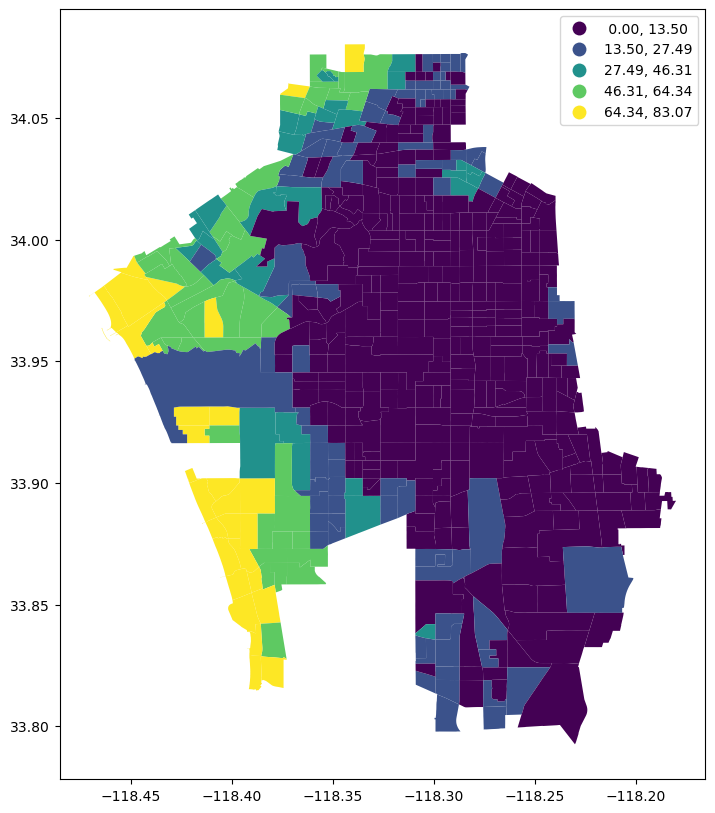

In [105]:
district2_tracts_race.plot(figsize=(12,10),
                            column='percent_white',
                 legend=True, 
                 scheme='NaturalBreaks')


<Axes: >

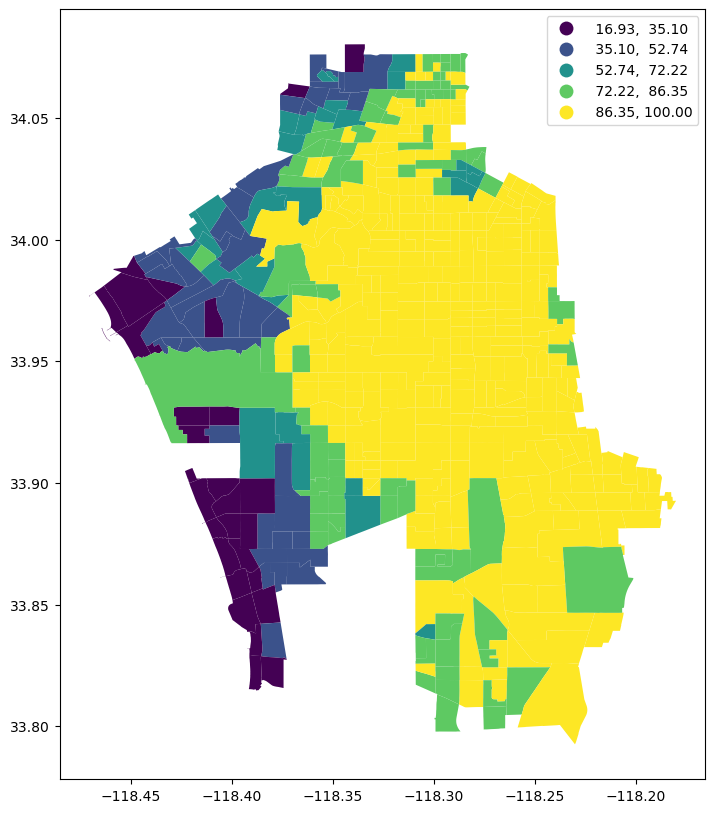

In [106]:
district2_tracts_race.plot(figsize=(12,10),
                            column='tracts_nonwhite',
                 legend=True, 
                 scheme='NaturalBreaks')

### Let me try this with District 5.

In [107]:
district5 = pd.read_csv(
    'data/District5.csv',
    dtype=
    {
        'CT20':str
    }
)
district2.info(verbose=True, show_counts=True)

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 506 entries, 0 to 505
Data columns (total 16 columns):
 #   Column         Non-Null Count  Dtype  
---  ------         --------------  -----  
 0   OBJECTID_12    506 non-null    int64  
 1   Join_Count     506 non-null    int64  
 2   TARGET_FID     506 non-null    int64  
 3   CT20           506 non-null    object 
 4   LABEL          506 non-null    float64
 5   NAME           506 non-null    object 
 6   SUP_NAME       506 non-null    object 
 7   DIST_SUP       506 non-null    int64  
 8   CITYNAME_ALF   451 non-null    object 
 9   NAME_1         66 non-null     object 
 10  JURISDICTION   506 non-null    object 
 11  AREA_NUM       506 non-null    int64  
 12  AREA_NAME      506 non-null    object 
 13  Shape__Area    506 non-null    float64
 14  Shape__Length  506 non-null    float64
 15  GEO_ID         506 non-null    object 
dtypes: float64(3), int64(5), object(8)
memory usage: 63.4+ KB


In [108]:
district2.head(10)

,OBJECTID_12,Join_Count,TARGET_FID,CT20,LABEL,NAME,SUP_NAME,DIST_SUP,CITYNAME_ALF,NAME_1,JURISDICTION,AREA_NUM,AREA_NAME,Shape__Area,Shape__Length,GEO_ID
0,640,2,640,211000,2110.00,2ND SUP. DISTRICT,2ND DISTRICT: HOLLY MITCHELL,2,LOS ANGELES,NaN,INCORPORATED CITY,5,Westside Planning Area,3.881413e+06,9270.888577,06037211000
1,641,2,641,211121,2111.21,2ND SUP. DISTRICT,2ND DISTRICT: HOLLY MITCHELL,2,LOS ANGELES,NaN,INCORPORATED CITY,9,Metro Planning Area,3.125745e+05,2799.117227,06037211121
2,642,3,642,211122,2111.22,2ND SUP. DISTRICT,2ND DISTRICT: HOLLY MITCHELL,2,LOS ANGELES,NaN,INCORPORATED CITY,9,Metro Planning Area,5.341218e+05,3050.487937,06037211122
3,643,2,643,211123,2111.23,2ND SUP. DISTRICT,2ND DISTRICT: HOLLY MITCHELL,2,LOS ANGELES,NaN,INCORPORATED CITY,9,Metro Planning Area,2.513022e+05,2501.035059,06037211123
4,644,2,644,211124,2111.24,2ND SUP. DISTRICT,2ND DISTRICT: HOLLY MITCHELL,2,LOS ANGELES,NaN,INCORPORATED CITY,9,Metro Planning Area,5.771177e+05,3012.923477,06037211124
5,645,2,645,211201,2112.01,2ND SUP. DISTRICT,2ND DISTRICT: HOLLY MITCHELL,2,LOS ANGELES,NaN,INCORPORATED CITY,9,Metro Planning Area,2.036427e+05,1811.419313,06037211201
6,646,3,646,211202,2112.02,2ND SUP. DISTRICT,2ND DISTRICT: HOLLY MITCHELL,2,LOS ANGELES,NaN,INCORPORATED CITY,9,Metro Planning Area,2.617965e+05,2048.091994,06037211202
7,647,1,647,211310,2113.10,2ND SUP. DISTRICT,2ND DISTRICT: HOLLY MITCHELL,2,LOS ANGELES,NaN,INCORPORATED CITY,9,Metro Planning Area,2.103028e+05,1841.910789,06037211310
8,648,1,648,211320,2113.20,2ND SUP. DISTRICT,2ND DISTRICT: HOLLY MITCHELL,2,LOS ANGELES,NaN,INCORPORATED CITY,9,Metro Planning Area,2.721546e+05,2090.392142,06037211320
9,649,2,649,211410,2114.10,2ND SUP. DISTRICT,2ND DISTRICT: HOLLY MITCHELL,2,LOS ANGELES,NaN,INCORPORATED CITY,5,Metro Planning Area,3.956623e+05,2766.191348,06037211410


In [109]:
district5['GEO_ID'] ='06' + '037' + district5['CT20']
district5.info(verbose=True, show_counts=True)

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 448 entries, 0 to 447
Data columns (total 16 columns):
 #   Column         Non-Null Count  Dtype  
---  ------         --------------  -----  
 0   OBJECTID_12    448 non-null    int64  
 1   Join_Count     448 non-null    int64  
 2   TARGET_FID     448 non-null    int64  
 3   CT20           448 non-null    object 
 4   LABEL          448 non-null    float64
 5   NAME           448 non-null    object 
 6   SUP_NAME       448 non-null    object 
 7   DIST_SUP       448 non-null    int64  
 8   CITYNAME_ALF   384 non-null    object 
 9   NAME_1         72 non-null     object 
 10  JURISDICTION   448 non-null    object 
 11  AREA_NUM       448 non-null    int64  
 12  AREA_NAME      448 non-null    object 
 13  Shape__Area    448 non-null    float64
 14  Shape__Length  448 non-null    float64
 15  GEO_ID         448 non-null    object 
dtypes: float64(3), int64(5), object(8)
memory usage: 56.1+ KB


In [110]:
district5.head()

,OBJECTID_12,Join_Count,TARGET_FID,CT20,LABEL,NAME,SUP_NAME,DIST_SUP,CITYNAME_ALF,NAME_1,JURISDICTION,AREA_NUM,AREA_NAME,Shape__Area,Shape__Length,GEO_ID
0,1,1,1,101110,1011.10,5TH SUP. DISTRICT,5TH DISTRICT: KATHRYN BARGER,5,LOS ANGELES,NaN,INCORPORATED CITY,3,San Fernando Valley Planning Area,1.676519e+06,5565.411341,06037101110
1,2,1,2,101122,1011.22,5TH SUP. DISTRICT,5TH DISTRICT: KATHRYN BARGER,5,LOS ANGELES,NaN,INCORPORATED CITY,3,San Fernando Valley Planning Area,3.881001e+06,11695.304277,06037101122
2,3,1,3,101220,1012.20,5TH SUP. DISTRICT,5TH DISTRICT: KATHRYN BARGER,5,LOS ANGELES,NaN,INCORPORATED CITY,3,San Fernando Valley Planning Area,1.025452e+06,4688.607147,06037101220
3,4,1,4,101221,1012.21,5TH SUP. DISTRICT,5TH DISTRICT: KATHRYN BARGER,5,LOS ANGELES,NaN,INCORPORATED CITY,3,San Fernando Valley Planning Area,5.197057e+05,3378.824327,06037101221
4,5,1,5,101222,1012.22,5TH SUP. DISTRICT,5TH DISTRICT: KATHRYN BARGER,5,LOS ANGELES,NaN,INCORPORATED CITY,3,San Fernando Valley Planning Area,4.350619e+05,3685.233312,06037101222


In [111]:
district5_tracts_race = tracts_race.merge(district5,on = "GEO_ID")
district5_tracts_race.head()

,OBJECTID,CT20_x,LABEL_x,ShapeSTArea,ShapeSTLength,geometry,GEO_ID,Total,White,Black,...,NAME,SUP_NAME,DIST_SUP,CITYNAME_ALF,NAME_1,JURISDICTION,AREA_NUM,AREA_NAME,Shape__Area,Shape__Length
0,4992,101110,1011.10,1.229562e+07,15083.854287,"POLYGON ((-118.29793 34.26323, -118.30082 34.2...",06037101110,4926,3065,74,...,5TH SUP. DISTRICT,5TH DISTRICT: KATHRYN BARGER,5,LOS ANGELES,NaN,INCORPORATED CITY,3,San Fernando Valley Planning Area,1.676519e+06,5565.411341
1,4993,101122,1011.22,2.845774e+07,31671.455844,"POLYGON ((-118.27743 34.25991, -118.27743 34.2...",06037101122,3728,2723,31,...,5TH SUP. DISTRICT,5TH DISTRICT: KATHRYN BARGER,5,LOS ANGELES,NaN,INCORPORATED CITY,3,San Fernando Valley Planning Area,3.881001e+06,11695.304277
2,4994,101220,1012.20,7.522093e+06,12698.783810,"POLYGON ((-118.27818 34.25577, -118.27887 34.2...",06037101220,3344,1901,42,...,5TH SUP. DISTRICT,5TH DISTRICT: KATHRYN BARGER,5,LOS ANGELES,NaN,INCORPORATED CITY,3,San Fernando Valley Planning Area,1.025452e+06,4688.607147
3,4995,101221,1012.21,3.812000e+06,9161.710543,"POLYGON ((-118.28735 34.25591, -118.28863 34.2...",06037101221,3444,2009,87,...,5TH SUP. DISTRICT,5TH DISTRICT: KATHRYN BARGER,5,LOS ANGELES,NaN,INCORPORATED CITY,3,San Fernando Valley Planning Area,5.197057e+05,3378.824327
4,4996,101222,1012.22,3.191371e+06,9980.600461,"POLYGON ((-118.28594 34.25590, -118.28697 34.2...",06037101222,2808,1551,94,...,5TH SUP. DISTRICT,5TH DISTRICT: KATHRYN BARGER,5,LOS ANGELES,NaN,INCORPORATED CITY,3,San Fernando Valley Planning Area,4.350619e+05,3685.233312


In [112]:
district5_tracts_race.info(verbose=True, show_counts=True)

<class 'geopandas.geodataframe.GeoDataFrame'>
RangeIndex: 448 entries, 0 to 447
Data columns (total 33 columns):
 #   Column           Non-Null Count  Dtype   
---  ------           --------------  -----   
 0   OBJECTID         448 non-null    int64   
 1   CT20_x           448 non-null    object  
 2   LABEL_x          448 non-null    object  
 3   ShapeSTArea      448 non-null    float64 
 4   ShapeSTLength    448 non-null    float64 
 5   geometry         448 non-null    geometry
 6   GEO_ID           448 non-null    object  
 7   Total            448 non-null    int64   
 8   White            448 non-null    int64   
 9   Black            448 non-null    int64   
 10  NativeAmerican   448 non-null    int64   
 11  Asian            448 non-null    int64   
 12  HawaiianAPI      448 non-null    int64   
 13  Other            448 non-null    int64   
 14  Twoplus          448 non-null    int64   
 15  nonwhite         448 non-null    int64   
 16  tracts_nonwhite  445 non-null    flo

<Axes: >

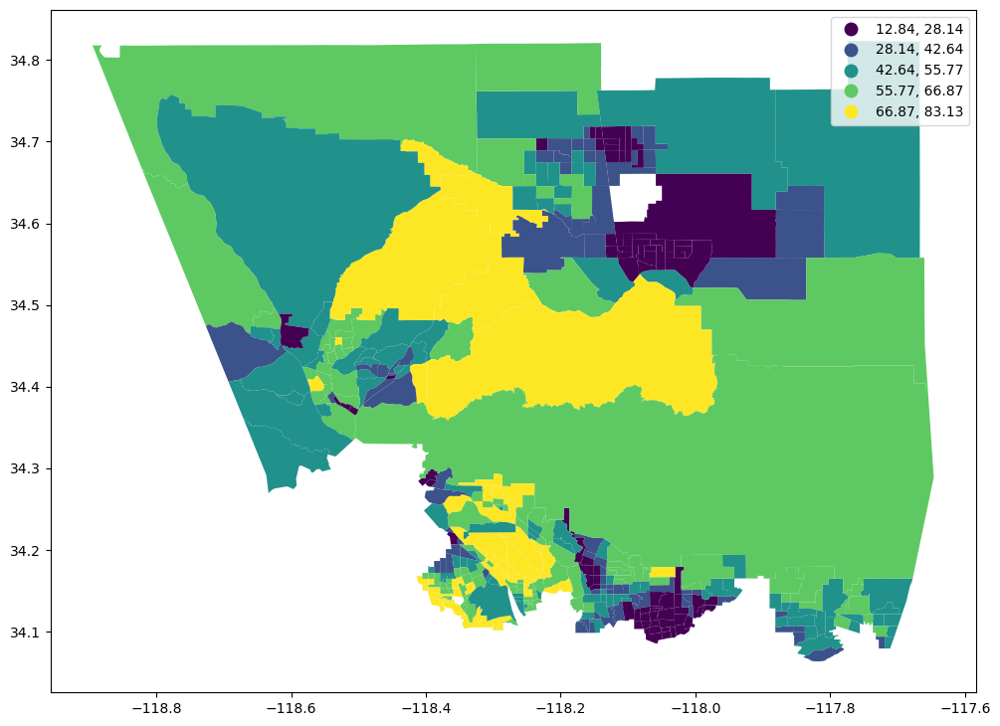

In [113]:
district5_tracts_race.plot(figsize=(12,10),
                            column='percent_white',
                 legend=True, 
                 scheme='NaturalBreaks')

<Axes: >

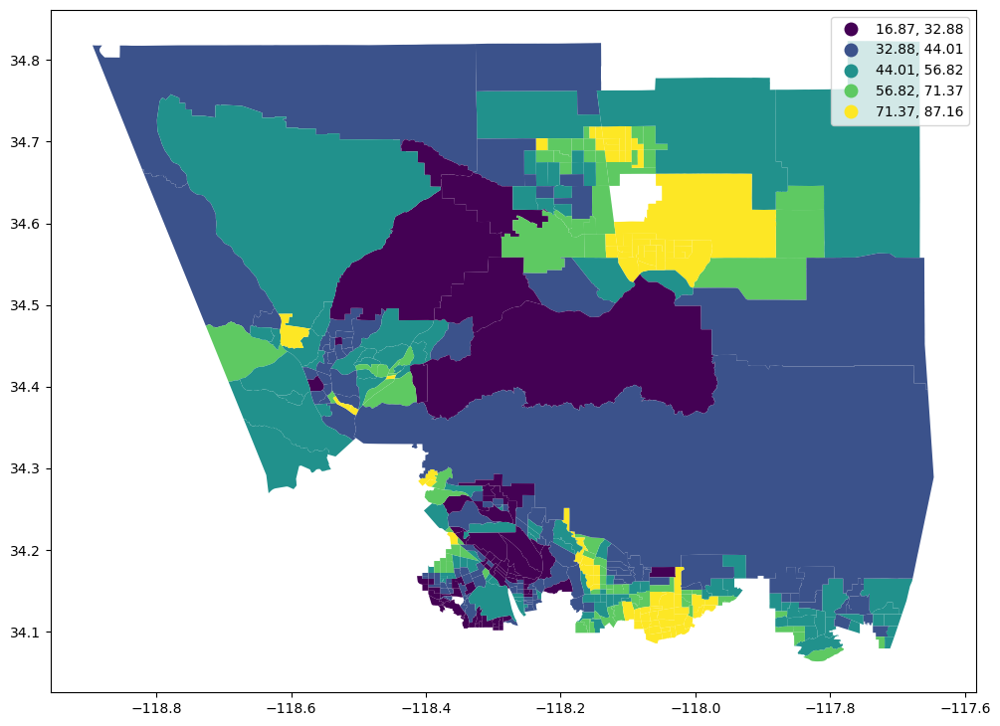

In [114]:
district5_tracts_race.plot(figsize=(12,10),
                            column='tracts_nonwhite',
                 legend=True, 
                 scheme='NaturalBreaks')

### Now that I've located where people of different racial identity groups live within districts 2 and 5, I'm ready to see where they are located in relation to parks and open spaces.

In [115]:
parks = gpd.read_file('data/Countywide_Parks_and_Open_Space_(Public_-_Hosted).geojson')
parks.head()

,OBJECTID,UNIT_ID,LMS_ID,PARK_NAME,PARK_LBL,ACCESS_TYP,RPT_ACRES,GIS_ACRES,AGNCY_NAME,AGNCY_LEV,...,CENTER_LON,ADDRESS,CITY,ZIP,HOURS,PHONES,IS_COUNTY,Shape__Area,Shape__Length,geometry
0,1,30.0,23603.0,El Barrio Park,El Barrio Park,Open Access,2.093,2.092992,"Claremont, City of",City,...,-117.704423,400 Claremont Blvd,Claremont,91711,None,None,No,9.117036e+04,1451.547906,"POLYGON ((-117.70383 34.09747, -117.70421 34.0..."
1,2,56.0,NaN,El Dorado Park,El Dorado Park,Open Access,5.144,5.143217,"Lancaster, City of",City,...,-118.122109,44501 5th St E,Lancaster,93535,None,None,No,2.240376e+05,2192.277128,"POLYGON ((-118.12252 34.69275, -118.12252 34.6..."
2,3,62.0,3000015.0,Atlantic Avenue Park,Atlantic Avenue Park,Open Access,1.960,1.959610,"Los Angeles, County of",County,...,-118.155201,570 S. Atlantic Blvd.,Los Angeles,90022,March 1st to October 31st<br>\nOperating Hours...,General/Aquatics: (323) 260-2341; Reservations...,Yes,8.536029e+04,1139.269960,"POLYGON ((-118.15541 34.02582, -118.15540 34.0..."
3,4,72.0,22715.0,El Escorpion Park,El Escorpion Park,Open Access,66.914,66.338029,"Los Angeles, City of",City,...,-118.664169,6801 Sunset Ridge Ct,West Hills,91307,None,(818) 883-6641,No,2.889673e+06,7761.831975,"POLYGON ((-118.66713 34.19881, -118.66714 34.1..."
4,5,78.0,22860.0,El Marino Park/ El Marino Elementary,El Marino Park Elementary/El Marino Park,Open Access,3.200,1.650439,"Culver City, City of",City,...,-118.399233,11450 Port Rd,Culver City,90230,None,None,No,7.189283e+04,1215.415276,"POLYGON ((-118.39909 33.99221, -118.39910 33.9..."


### Let me map this and see what I'm working with. 

<Axes: >

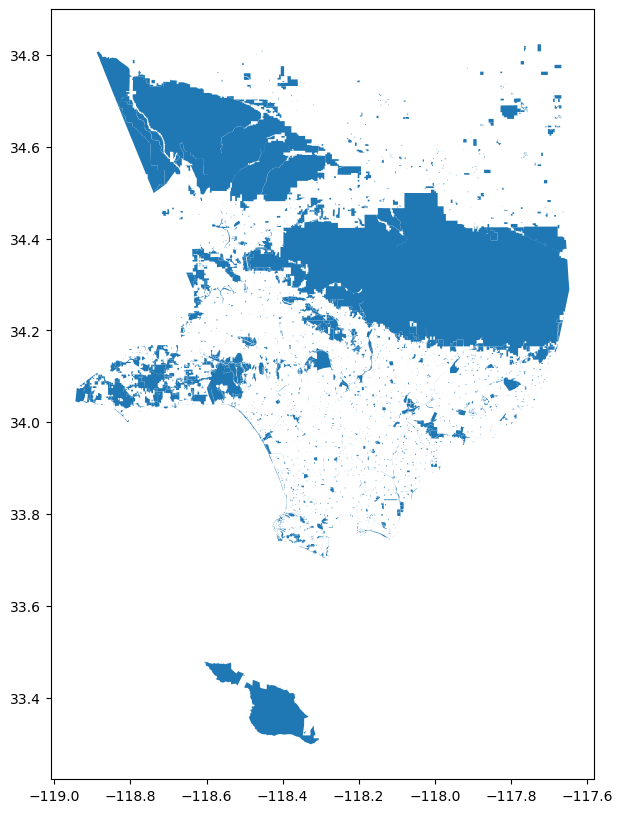

In [116]:
parks.plot(figsize=(12,10))

### I'm check and see if there's anything I can use to merge the parks data with my previous merges.

In [117]:
 parks.info(verbose=True, show_counts=True)

<class 'geopandas.geodataframe.GeoDataFrame'>
RangeIndex: 3012 entries, 0 to 3011
Data columns (total 53 columns):
 #   Column         Non-Null Count  Dtype   
---  ------         --------------  -----   
 0   OBJECTID       3012 non-null   int64   
 1   UNIT_ID        3011 non-null   float64 
 2   LMS_ID         1263 non-null   float64 
 3   PARK_NAME      3012 non-null   object  
 4   PARK_LBL       3012 non-null   object  
 5   ACCESS_TYP     3012 non-null   object  
 6   RPT_ACRES      3012 non-null   float64 
 7   GIS_ACRES      3012 non-null   float64 
 8   AGNCY_NAME     3012 non-null   object  
 9   AGNCY_LEV      3012 non-null   object  
 10  AGNCY_TYP      3012 non-null   object  
 11  AGNCY_WEB      3010 non-null   object  
 12  MNG_AGENCY     3012 non-null   object  
 13  COGP_TYP       3011 non-null   object  
 14  NDS_AN_TYP     3009 non-null   object  
 15  NEEDS_ANLZ     3010 non-null   object  
 16  TKIT_SUM       3010 non-null   object  
 17  AMEN_RPT       3010 non-n

### I see that geometry could be a match. Hopefully, that will work!

In [118]:
parks_locationsD2 = district2_tracts_race.merge(parks,on = "geometry")
parks_locationsD2.info(verbose=True, show_counts=True)

<class 'geopandas.geodataframe.GeoDataFrame'>
RangeIndex: 0 entries
Data columns (total 85 columns):
 #   Column           Non-Null Count  Dtype   
---  ------           --------------  -----   
 0   OBJECTID_x       0 non-null      int64   
 1   CT20_x           0 non-null      object  
 2   LABEL_x          0 non-null      object  
 3   ShapeSTArea      0 non-null      float64 
 4   ShapeSTLength    0 non-null      float64 
 5   geometry         0 non-null      geometry
 6   GEO_ID           0 non-null      object  
 7   Total            0 non-null      int64   
 8   White            0 non-null      int64   
 9   Black            0 non-null      int64   
 10  NativeAmerican   0 non-null      int64   
 11  Asian            0 non-null      int64   
 12  HawaiianAPI      0 non-null      int64   
 13  Other            0 non-null      int64   
 14  Twoplus          0 non-null      int64   
 15  nonwhite         0 non-null      int64   
 16  tracts_nonwhite  0 non-null      float64 
 17  p

### That didn't seem to work. I'm going to play around with some new python libraries to see if that'll help.
### Before that, I'm curious about the 'TOTAL_GOOD' indicator. I think this will be a great indicator of the quality of the park because the metadata says that this value corresponds to the number of amenities in good quality.
### This table below shows the left column as the total number of good amenities. The right column says how many of the parks or open spaces in the district have this value.

In [119]:
parks_locationsD2['TOTAL_GOOD'].value_counts()

Series([], Name: count, dtype: int64)

In [144]:
parks_locationsD2['TOTAL_GOOD'].sample(20)

344     3.0
147     3.0
111     0.0
136     0.0
52      1.0
76     23.0
248     3.0
125     4.0
400     0.0
152     0.0
289     0.0
40      0.0
426     0.0
250     0.0
460     1.0
154    11.0
232     6.0
297     0.0
41      1.0
198     0.0
Name: TOTAL_GOOD, dtype: float64

### Now that that's decided, I'll try the geopandas.overlay one since it seems to work with datasets that have similar geometries.

In [120]:
from shapely.geometry import Polygon
geopandas = gpd
parks_locationsD2 = geopandas.overlay(district2_tracts_race, parks, how='intersection', keep_geom_type=None, make_valid=True)

In [121]:
parks_locationsD2.head()

,OBJECTID_1,CT20_x,LABEL_x,ShapeSTArea,ShapeSTLength,GEO_ID,Total,White,Black,NativeAmerican,...,CENTER_LON,ADDRESS,CITY,ZIP,HOURS,PHONES,IS_COUNTY,Shape__Area_2,Shape__Length_2,geometry
0,5634,211123,2111.23,1.851716e+06,6798.256629,06037211123,2097,368,125,4,...,-118.284035,625 Lafayette Park Pl,Los Angeles,90057,None,(213) 384-0562,No,395441.442383,3500.041635,"POLYGON ((-118.28338 34.06158, -118.28426 34.0..."
1,5656,212204,2122.04,2.294673e+06,6149.261568,06037212204,3227,336,209,131,...,-118.284035,625 Lafayette Park Pl,Los Angeles,90057,None,(213) 384-0562,No,395441.442383,3500.041635,"POLYGON ((-118.28409 34.06049, -118.28410 34.0..."
2,5635,211124,2111.24,4.252116e+06,8179.690837,06037211124,4070,461,193,53,...,-118.289562,3191 4th St,Los Angeles,90020,None,(213) 386-8877,No,237682.605469,2190.429976,"POLYGON ((-118.28920 34.06811, -118.28860 34.0..."
3,5642,211500,2115.00,9.784612e+06,13106.019300,06037211500,4230,1724,151,46,...,-118.316199,4900 Beverly Blvd,Los Angeles,90004,None,(213) 847-3599,No,73048.368164,1115.384387,"POLYGON ((-118.31585 34.07522, -118.31651 34.0..."
4,5654,212202,2122.02,2.222403e+06,6482.090647,06037212202,3364,366,156,87,...,-118.289425,2909 Francis Ave,Los Angeles,90005,None,None,No,6750.990234,370.020208,"POLYGON ((-118.28952 34.05690, -118.28952 34.0..."


### Let me check with a map.

<Axes: >

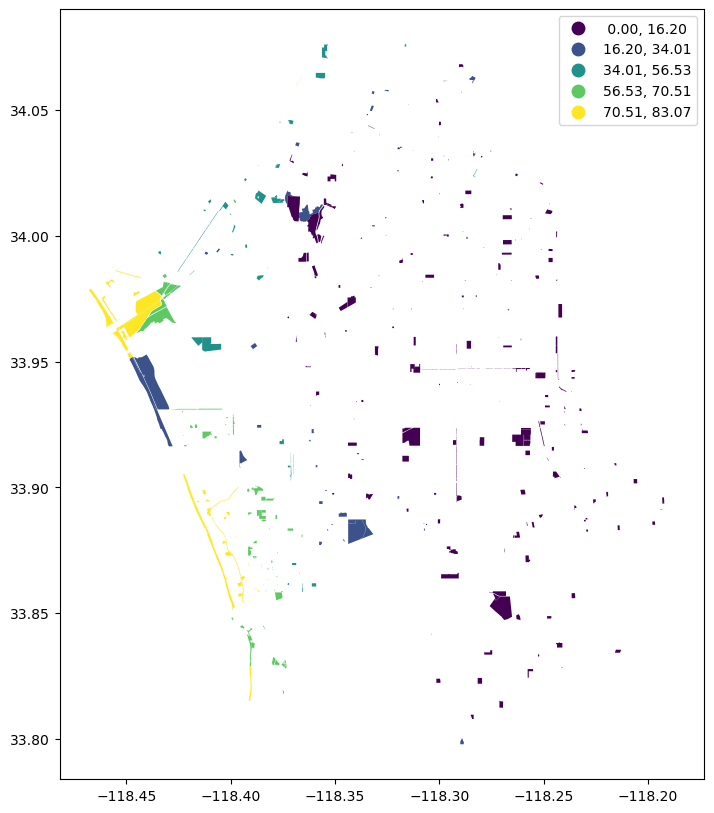

In [122]:
parks_locationsD2.plot(figsize=(12,10),
                            column='percent_white',
                 legend=True, 
                 scheme='NaturalBreaks')

### Let me try this again with nonwhite people. 

<Axes: >

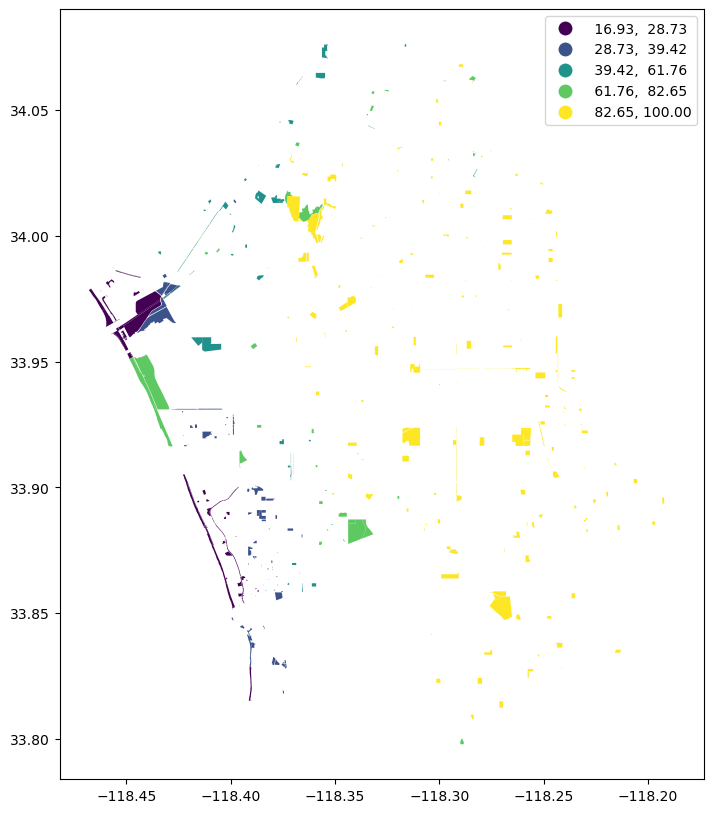

In [123]:
parks_locationsD2.plot(figsize=(12,10),
                            column='tracts_nonwhite',
                 legend=True, 
                 scheme='NaturalBreaks')

### Now I will do this with District 5. 

In [124]:
parks_locationsD5 = district5_tracts_race.merge(parks,on = "geometry")
parks_locationsD5.info(verbose=True, show_counts=True)

<class 'geopandas.geodataframe.GeoDataFrame'>
RangeIndex: 0 entries
Data columns (total 85 columns):
 #   Column           Non-Null Count  Dtype   
---  ------           --------------  -----   
 0   OBJECTID_x       0 non-null      int64   
 1   CT20_x           0 non-null      object  
 2   LABEL_x          0 non-null      object  
 3   ShapeSTArea      0 non-null      float64 
 4   ShapeSTLength    0 non-null      float64 
 5   geometry         0 non-null      geometry
 6   GEO_ID           0 non-null      object  
 7   Total            0 non-null      int64   
 8   White            0 non-null      int64   
 9   Black            0 non-null      int64   
 10  NativeAmerican   0 non-null      int64   
 11  Asian            0 non-null      int64   
 12  HawaiianAPI      0 non-null      int64   
 13  Other            0 non-null      int64   
 14  Twoplus          0 non-null      int64   
 15  nonwhite         0 non-null      int64   
 16  tracts_nonwhite  0 non-null      float64 
 17  p

### Checking the same thing regarding total good amenities as before. 

In [125]:
parks_locationsD5['TOTAL_GOOD'].value_counts()

Series([], Name: count, dtype: int64)

In [147]:
parks_locationsD5['TOTAL_GOOD'].sample(20)

14       0.0
323      0.0
814      1.0
550     13.0
185      0.0
4        0.0
288      0.0
94       0.0
458      0.0
460      0.0
976      0.0
660      1.0
1021     6.0
41       0.0
650      2.0
535      3.0
211      0.0
362      0.0
90       1.0
655      0.0
Name: TOTAL_GOOD, dtype: float64

### Following the same steps for the overlay. 

In [126]:
from shapely.geometry import Polygon
geopandas = gpd
parks_locationsD5 = geopandas.overlay(district5_tracts_race, parks, how='intersection', keep_geom_type=None, make_valid=True)

/tmp/ipykernel_73/2338594882.py:3: UserWarning: `keep_geom_type=True` in overlay resulted in 5 dropped geometries of different geometry types than df1 has. Set `keep_geom_type=False` to retain all geometries
  parks_locationsD5 = geopandas.overlay(district5_tracts_race, parks, how='intersection', keep_geom_type=None, make_valid=True)


In [127]:
parks_locationsD5.head()

,OBJECTID_1,CT20_x,LABEL_x,ShapeSTArea,ShapeSTLength,GEO_ID,Total,White,Black,NativeAmerican,...,CENTER_LON,ADDRESS,CITY,ZIP,HOURS,PHONES,IS_COUNTY,Shape__Area_2,Shape__Length_2,geometry
0,4992,101110,1011.10,1.229562e+07,15083.854287,06037101110,4926,3065,74,53,...,-118.300655,7747 Foothill Blvd,Tujunga,91042,None,(818) 899-4537,No,5.214521e+04,9.157808e+02,"POLYGON ((-118.30092 34.25869, -118.30091 34.2..."
1,5004,103102,1031.02,1.335709e+07,16530.394261,06037103102,4752,3220,25,32,...,-118.300655,7747 Foothill Blvd,Tujunga,91042,None,(818) 899-4537,No,5.214521e+04,9.157808e+02,"POLYGON ((-118.30088 34.25870, -118.30091 34.2..."
2,4992,101110,1011.10,1.229562e+07,15083.854287,06037101110,4926,3065,74,53,...,-118.300504,10654 Irma Ave,Tujunga,91042,None,(818) 353-1365,No,3.280699e+04,7.789355e+02,"POLYGON ((-118.30031 34.26246, -118.30069 34.2..."
3,4993,101122,1011.22,2.845774e+07,31671.455844,06037101122,3728,2723,31,28,...,-118.293310,None,Tujunga,91042,None,None,No,1.063996e+06,4.388261e+03,"POLYGON ((-118.29391 34.27522, -118.29386 34.2..."
4,4993,101122,1011.22,2.845774e+07,31671.455844,06037101122,3728,2723,31,28,...,-118.177686,33708 Crown Valley Rd,Acton,93510,None,None,No,2.796477e+10,5.306825e+06,"MULTIPOLYGON (((-118.27730 34.26363, -118.2773..."


<Axes: >

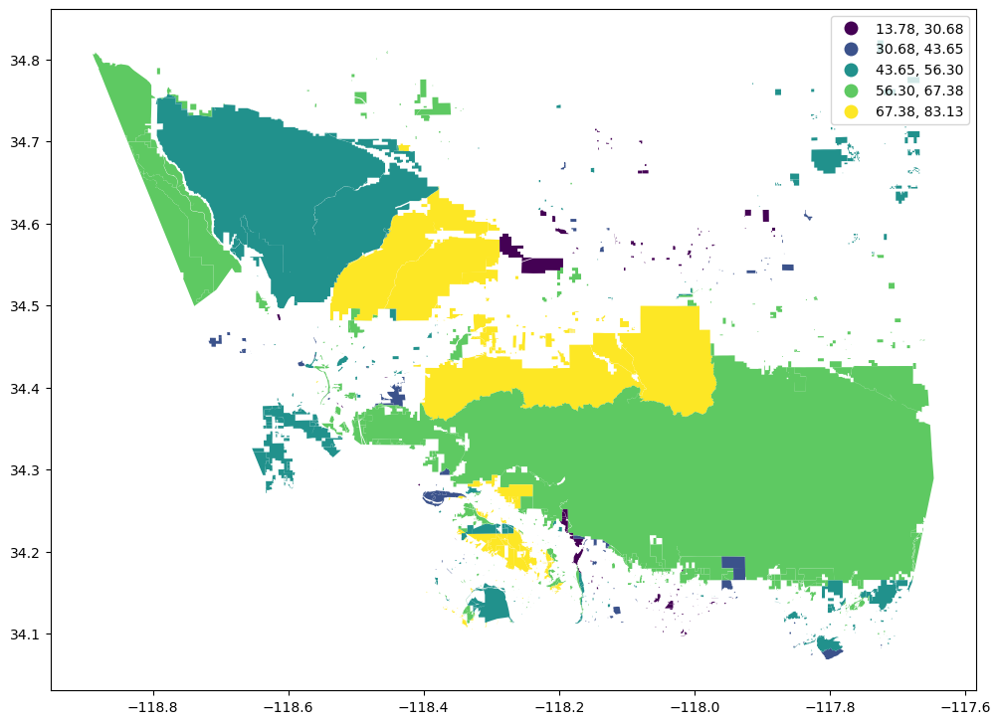

In [128]:
parks_locationsD5.plot(figsize=(12,10),
                            column='percent_white',
                 legend=True, 
                 scheme='NaturalBreaks')

<Axes: >

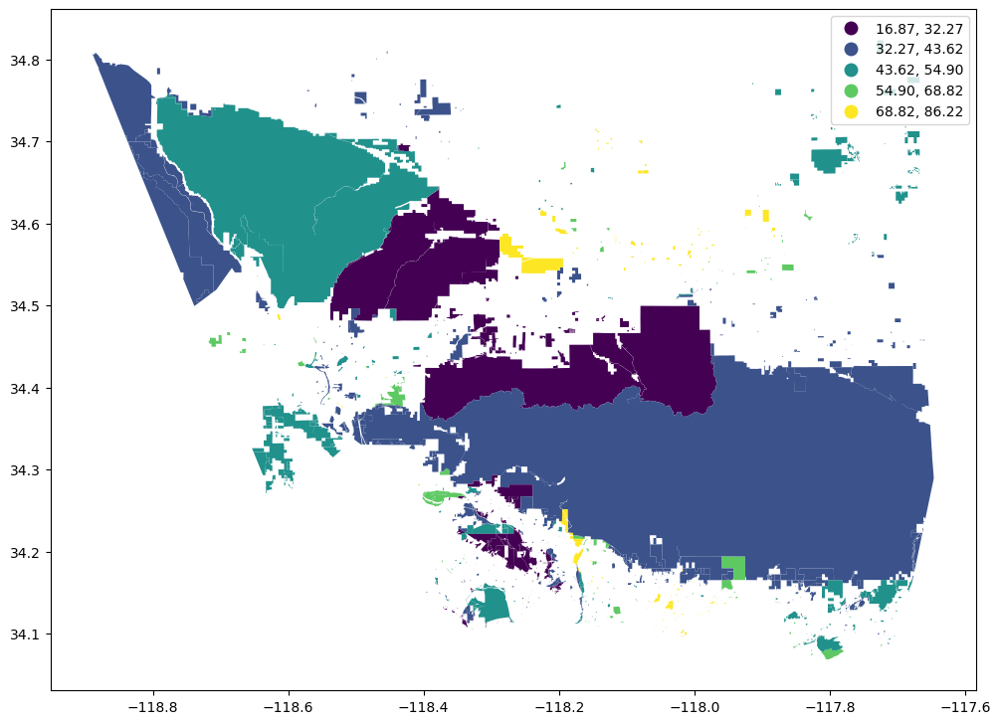

In [129]:
parks_locationsD5.plot(figsize=(12,10),
                            column='tracts_nonwhite',
                 legend=True, 
                 scheme='NaturalBreaks')

# Folium
### Before I finish, I want to make sure I can interact with this data on a larger map.

In [130]:
import folium
import branca

### I first need to initiate the colormap from the branca library.

In [131]:
colormap = branca.colormap.LinearColormap(
    vmin=parks_locationsD2['percent_white'].quantile(0.0), #leftbound of the color scale
    vmax=parks_locationsD2['percent_white'].quantile(1), #rightbound of the color scale
    
    colors=['#ffffb2',
            '#fecc5c',
            '#fd8d3c',
            '#f03b20',
            '#bd0026'], #used a yellow to red scale from colorbrewer2.org
    caption="Percent of White People in D2 Census Tracts Where Parks and Open Spaces Are",
)

### Now I will make the map with pop ups that identify the percentage of white people along with the number of good amenitites at the site identified when you interact with it.

In [132]:
mp = folium.Map(location=[34.2,-118.2], 
               zoom_start = 10, 
               tiles='CartoDB positron', 
               attribution='CartoDB')

#making the popup that will go in the map
popup = folium.GeoJsonPopup(
    fields=['PARK_NAME', 'percent_white','TOTAL_GOOD'], 
    aliases=["Park:", '% White:','Number of Good Amenities:'],
    localize=True,
    labels=True,
    style='background-color: blue;',
)

#making the GeoJson map
folium.GeoJson(
    parks_locationsD2,
    
    style_function=lambda x: {
        "fillColor": colormap(x["properties"]["percent_white"]) 
        if x["properties"]["percent_white"] is not None
        else "transparent",
        "color": "black",
        "weight": 1, #want to make the black lines less thick
        "fillOpacity": 1, #turn off opacity for now
    },
    
    popup=popup, 
).add_to(mp)

colormap.add_to(mp)

mp

In [133]:
mp.save('D2_LA_White_Population.html')

### I'm going to do this with nonwhite people in District 2 as well. 

In [134]:
colormap = branca.colormap.LinearColormap(
    vmin=parks_locationsD2['tracts_nonwhite'].quantile(0.0), #leftbound of the color scale
    vmax=parks_locationsD2['tracts_nonwhite'].quantile(1), #rightbound of the color scale
    
    colors=['#ffffb2',
            '#fecc5c',
            '#fd8d3c',
            '#f03b20',
            '#bd0026'], #used a yellow to red scale from colorbrewer2.org
    caption="Percent of Nonwhite People in D2 Census Tracts Where Parks and Open Spaces Are",
)

In [135]:
mp = folium.Map(location=[34.2,-118.2], 
               zoom_start = 10, 
               tiles='CartoDB positron', 
               attribution='CartoDB')

#making the popup that will go in the map
popup = folium.GeoJsonPopup(
    fields=['PARK_NAME', 'tracts_nonwhite','TOTAL_GOOD'], 
    aliases=["Park:", '% Nonwhite:','Number of Good Amenities:'],
    localize=True,
    labels=True,
    style='background-color: blue;',
)

#making the GeoJson map
folium.GeoJson(
    parks_locationsD2,
    
    style_function=lambda x: {
        "fillColor": colormap(x["properties"]["tracts_nonwhite"]) 
        if x["properties"]["tracts_nonwhite"] is not None
        else "transparent",
        "color": "black",
        "weight": 1, #want to make the black lines less thick
        "fillOpacity": 1, #turn off opacity for now
    },
    
    popup=popup, 
).add_to(mp)

colormap.add_to(mp)

mp

In [136]:
mp.save('D2_LA_Nonwhite_Population.html')

### I will do this with District 5 now. 

In [137]:
colormap = branca.colormap.LinearColormap(
    vmin=parks_locationsD2['percent_white'].quantile(0.0), #leftbound of the color scale
    vmax=parks_locationsD2['percent_white'].quantile(1), #rightbound of the color scale
    
    colors=['#ffffb2',
            '#fecc5c',
            '#fd8d3c',
            '#f03b20',
            '#bd0026'], #used a yellow to red scale from colorbrewer2.org
    caption="Percent of White People in D5 Census Tracts Where Parks and Open Spaces Are",
)

In [138]:
mp = folium.Map(location=[34.2,-118.2], 
               zoom_start = 10, 
               tiles='CartoDB positron', 
               attribution='CartoDB')

#making the popup that will go in the map
popup = folium.GeoJsonPopup(
    fields=['PARK_NAME', 'percent_white','TOTAL_GOOD'], 
    aliases=["Park:", '% White:','Number of Good Amenities:'],
    localize=True,
    labels=True,
    style='background-color: blue;',
)

#making the GeoJson map
folium.GeoJson(
    parks_locationsD5,
    
    style_function=lambda x: {
        "fillColor": colormap(x["properties"]["percent_white"]) 
        if x["properties"]["percent_white"] is not None
        else "transparent",
        "color": "black",
        "weight": 1, #want to make the black lines less thick
        "fillOpacity": 1, #turn off opacity for now
    },
    
    popup=popup, 
).add_to(mp)

colormap.add_to(mp)

mp

In [139]:
mp.save('D5_LA_White_Population.html')

### For nonwhite people in District 5 as well. 

In [140]:
colormap = branca.colormap.LinearColormap(
    vmin=parks_locationsD2['tracts_nonwhite'].quantile(0.0), #leftbound of the color scale
    vmax=parks_locationsD2['tracts_nonwhite'].quantile(1), #rightbound of the color scale
    
    colors=['#ffffb2',
            '#fecc5c',
            '#fd8d3c',
            '#f03b20',
            '#bd0026'], #used a yellow to red scale from colorbrewer2.org
    caption="Percent of Nonwhite People in D5 Census Tracts Where Parks and Open Spaces Are",
)

In [141]:
mp = folium.Map(location=[34.2,-118.2], 
               zoom_start = 10, 
               tiles='CartoDB positron', 
               attribution='CartoDB')

#making the popup that will go in the map
popup = folium.GeoJsonPopup(
    fields=['PARK_NAME', 'tracts_nonwhite','TOTAL_GOOD'], 
    aliases=["Park:", '% Nonwhite:','Number of Good Amenities:'],
    localize=True,
    labels=True,
    style='background-color: blue;',
)

#making the GeoJson map
folium.GeoJson(
    parks_locationsD5,
    
    style_function=lambda x: {
        "fillColor": colormap(x["properties"]["tracts_nonwhite"]) 
        if x["properties"]["tracts_nonwhite"] is not None
        else "transparent",
        "color": "black",
        "weight": 1, #want to make the black lines less thick
        "fillOpacity": 1, #turn off opacity for now
    },
    
    popup=popup, 
).add_to(mp)

colormap.add_to(mp)

mp

In [142]:
mp.save('D5_LA_Nonwhite_Population.html')